In [2]:
import geopandas as gp
import shapefile
from json import dumps
import os
import folium

In [6]:
 
   # read the shapefile
reader = shapefile.Reader("/home/drogon/Desktop/Rescue-1122-project/PAK_adm1.shp")
fields = reader.fields[1:]
print "Fields", fields
field_names = [field[0] for field in fields]
print "Field_names",field_names
buffer = []
for sr in reader.shapeRecords():
   atr = dict(zip(field_names, sr.record))
   geom = sr.shape.__geo_interface__
   buffer.append(dict(type="Feature", geometry=geom, properties=atr))
   print buffer

Fields [['ID_0', 'N', 10, 0], ['ISO', 'C', 3, 0], ['NAME_0', 'C', 75, 0], ['ID_1', 'N', 10, 0], ['NAME_1', 'C', 75, 0], ['TYPE_1', 'C', 50, 0], ['ENGTYPE_1', 'C', 50, 0], ['NL_NAME_1', 'C', 50, 0], ['VARNAME_1', 'C', 150, 0]]
Field_names ['ID_0', 'ISO', 'NAME_0', 'ID_1', 'NAME_1', 'TYPE_1', 'ENGTYPE_1', 'NL_NAME_1', 'VARNAME_1']
[{'geometry': {'type': 'Polygon', 'coordinates': (((74.64929962158214, 35.139911651611385), (74.66885375976568, 35.12403106689459), (74.6848754882813, 35.11114883422857), (74.70606994628929, 35.09706115722656), (74.73509216308622, 35.09022521972662), (74.74940490722685, 35.08053207397461), (74.75949859619169, 35.073471069335994), (74.77753448486328, 35.06112670898449), (74.81513214111334, 35.04671096801769), (74.80111694335949, 35.02066040039074), (74.79392242431658, 35.00136184692377), (74.79238128662126, 34.97158813476568), (74.79097747802763, 34.95899963378912), (74.79145812988281, 34.94972991943371), (74.7881546020509, 34.93428802490246), (74.79141235351557

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [7]:
# write the GeoJSON file

geojson = open("PAK_adm1.geojson", "w")
geojson.write(dumps({"type": "FeatureCollection", "features": buffer}, indent=2) + "\n")
geojson.close()

In [3]:
pak_map = folium.Map(location=[30.3753, 69.3451],
                   tiles='Mapbox Bright', zoom_start=5)


In [10]:
pak_map.choropleth(geo_data='/home/drogon/Desktop/Rescue-1122-project/PAK_adm1.geojson')
pak_map

In [18]:
kanton_map.choropleth(geo_path='switzerland.geojson')

NameError: name 'kanton_map' is not defined

32


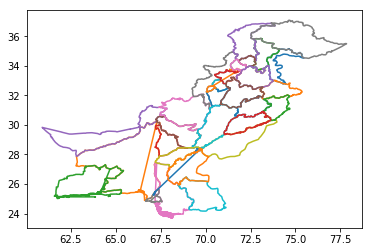

In [39]:
import shapefile as shp
import matplotlib.pyplot as plt
%matplotlib inline

sf = shp.Reader("/home/drogon/Desktop/Rescue-1122-project/PAK_adm2.shp")
print len(sf.shapes())
plt.figure()
for shape in sf.shapeRecords():
    x = [i[0] for i in shape.shape.points[:]]
    y = [i[1] for i in shape.shape.points[:]]
    plt.plot(x,y)
plt.show()

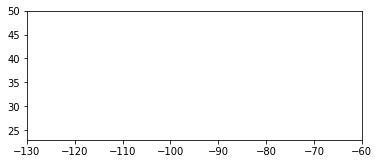

In [42]:
import numpy as np

plt.figure()
ax = plt.axes() # add the axes
ax.set_aspect('equal')

for shape in list(sf.iterShapes()):
    npoints=len(shape.points) # total points
    nparts = len(shape.parts) # total parts

    if nparts == 1:
        
        x_lon = np.zeros((len(shape.points),1))
        y_lat = np.zeros((len(shape.points),1))
        for ip in range(len(shape.points)):
            x_lon[ip] = shape.points[ip][0]
            y_lat[ip] = shape.points[ip][1]
        plt.plot(x_lon,y_lat)

    else: # loop over parts of each shape, plot separately
        for ip in range(nparts): # loop over parts, plot separately
            i0=shape.parts[ip]
            if ip < nparts-1:
                i1 = shape.parts[ip+1]-1
            else:
                i1 = npoints

            seg=shape.points[i0:i1+1]
            x_lon = np.zeros((len(seg),1))
            y_lat = np.zeros((len(seg),1))
            for ip in range(len(seg)):
                x_lon[ip] = seg[ip][0]
                y_lat[ip] = seg[ip][1]

            plt.plot(x_lon,y_lat)

plt.xlim(-130,-60)
plt.ylim(23,50)
plt.show()